In [1]:
import pandas as pd
import folium
import json

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
victims_df = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/TalentoTech/Base víctimas 31 de mayo 2025.xlsx')

# **Revisando la base de datos**

primer vistazo de reconocimiento del dataframe y la naturaleza de los datos dentro de la misma.




In [5]:
victims_df.shape

(12585, 43)

In [6]:
victims_df.columns

Index(['tipo de accidente', 'departamento', 'municipio', 'sitio', 'tipologia',
       'Fecha del accidente', 'Año', 'Mes', 'Coordenadas tomadas con',
       'latitude', 'longitude', 'cod_dane_muni', 'cod_dane_depto',
       'Tipo de lugar', 'Presunto actor responsable', 'descripción',
       'Tipo de área', 'id_imsma evento', 'accident_guid', 'condicion',
       'genero', 'estado', 'rango de edad', 'actividad', 'otra actividad',
       'reporte medico', 'pertenencia a un grupo etnico', 'etnia', 'comunidad',
       'resguardo consejo comunitario', 'verificado registraduria',
       'victim_guid', 'id_imsma_victima', 'amputación-pérdida final',
       'amputación-pérdida inicial', 'afectación auditiva',
       'afectación visual', 'esquirla', 'fractura', 'Heridas-laceraciones',
       'infeccion', 'quemadura', 'Fueza publica pertenece'],
      dtype='object')

In [7]:
victims_df.describe()

,Fecha del accidente,Año,Mes,latitude,longitude,cod_dane_muni,cod_dane_depto,verificado registraduria
count,12585,12585.000000,12585.000000,12585.000000,12585.000000,12585.000000,12585.000000,6389
mean,2007-12-06 03:40:31.208581632,2007.463806,6.103695,4.959277,-74.986934,39067.923004,38.600795,2016-10-27 00:36:45.415558144
min,1990-01-01 00:00:00,1990.000000,1.000000,-0.624722,-78.859270,5001.000000,5.000000,2015-07-15 07:00:00
25%,2004-06-27 15:45:00,2004.000000,3.000000,2.470833,-76.134258,13670.000000,13.000000,2015-08-26 00:00:00
50%,2007-03-25 12:40:00,2007.000000,6.000000,5.391944,-75.141600,41206.000000,41.000000,2015-08-26 00:00:00
75%,2011-03-29 07:00:00,2011.000000,9.000000,7.254977,-73.784832,54800.000000,54.000000,2017-07-11 00:00:00
max,2025-05-13 07:00:00,2025.000000,12.000000,11.716944,-67.500750,99773.000000,99.000000,2025-06-09 07:00:00
std,NaN,6.298794,3.323849,2.739831,1.733236,28178.321688,28.183589,NaN


In [8]:
import folium
import json

In [9]:
from pyspark.sql.functions import col, count

# Agrupar y contar por municipio y departamento
df_agrupado = victims_df.groupby(["municipio", "departamento"]).size().reset_index(name="concurrencias")


In [10]:
import folium

# Crear mapa centrado en Colombia
m = folium.Map(location=[4.5709, -74.2973], zoom_start=5)

# Añadir cada punto de víctimas al mapa
for _, row in victims_df.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=5,
        color='red',
        fill=True,
        fill_color='red',
        popup=f"{row['municipio']}, {row['departamento']}\n{row['tipo de accidente']}"
    ).add_to(m)

m

In [11]:
import json
with open("/content/drive/MyDrive/Colab Notebooks/TalentoTech/colombia_departamentos.geojson.txt", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

In [12]:
import folium
import pandas as pd
import requests
import json

# Agrupar por departamento y contar los casos
df_deptos = victims_df.groupby("departamento").size().reset_index(name="casos")

# Normalizar los nombres de departamento (mayúsculas) si es necesario
df_deptos["departamento"] = df_deptos["departamento"].str.upper().str.strip()

# Crear mapa centrado en Colombia
m = folium.Map(location=[4.5709, -74.2973], zoom_start=5)

# Crear mapa coroplético
folium.Choropleth(
    geo_data=geojson_data,
    data=df_deptos,
    columns=["departamento", "casos"],
    key_on="feature.properties.NOMBRE_DPT",
    fill_color="RdYlBu_r",  # Azul a rojo invertido
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Casos de minas por departamento"
).add_to(m)

m


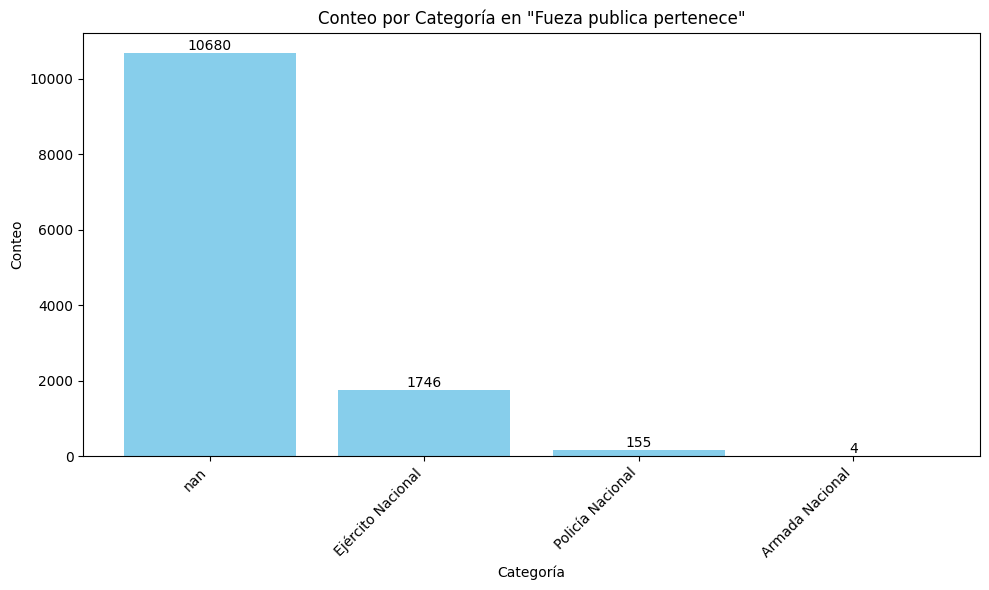

In [28]:
import matplotlib.pyplot as plt

# Conteo por categoría en "Fueza publica pertenece"
conteo_fuerza_publica = victims_df['Fueza publica pertenece'].value_counts(dropna=False)

# Crear la figura y la gráfica
plt.figure(figsize=(10, 6))
bars = plt.bar(conteo_fuerza_publica.index.astype(str), conteo_fuerza_publica.values, color='skyblue')

# Etiquetas de los ejes y título
plt.xlabel('Categoría')
plt.ylabel('Conteo')
plt.title('Conteo por Categoría en "Fueza publica pertenece"')

# Mostrar los valores encima de cada barra
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f'{int(height)}',
             ha='center', va='bottom', fontsize=10)

plt.xticks(rotation=45, ha='right')  # Rota las etiquetas si son largas
plt.tight_layout()
plt.show()


<Axes: title={'center': 'Distribución por Género'}, ylabel='count'>

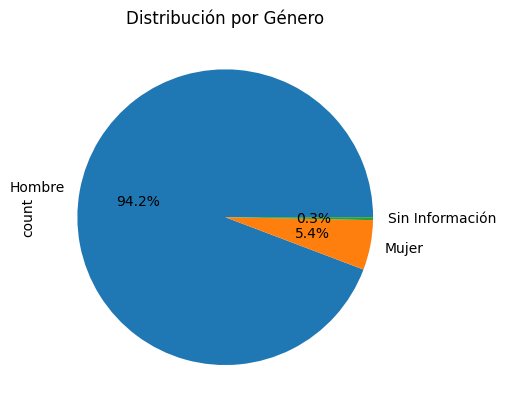

In [31]:
# Por género
victims_df['genero'].value_counts().plot(kind='pie', title='Distribución por Género', autopct='%1.1f%%')


<Axes: title={'center': 'Distribución por Rango de Edad'}, xlabel='rango de edad'>

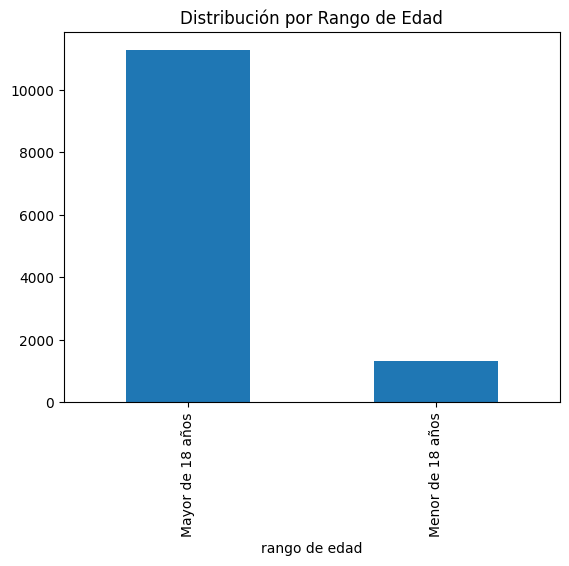

In [32]:
# Por rango de edad
victims_df['rango de edad'].value_counts().sort_index().plot(kind='bar', title='Distribución por Rango de Edad')


<Axes: title={'center': 'Pertenencia a grupo étnico'}, ylabel='pertenencia a un grupo etnico'>

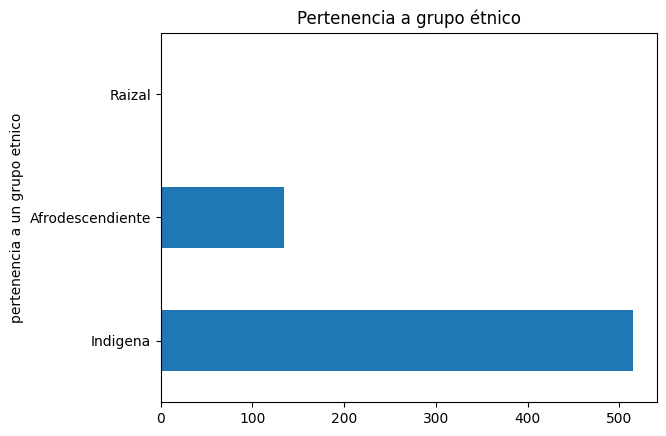

In [33]:

# Por grupo étnico
victims_df['pertenencia a un grupo etnico'].value_counts().plot(kind='barh', title='Pertenencia a grupo étnico')